# **MOWNIT** - Computional Methods AGH UST 2024

## Laboratory 4, Task1 

# Simulated Annealing (SA) Approach for TSP

Simulated Annealing is a metaheuristic optimization algorithm that is inspired by the process of annealing in metallurgy. In the context of solving the Traveling Salesman Problem (TSP), SA works by iteratively exploring potential solutions and gradually refining them to approach an optimal solution. Here's an explanation of the approach:

1. **Initial Solution**: Start with an initial solution,  generated randomly.

2. **Temperature Annealing Schedule**: SA maintains a parameter called temperature, which controls the probability of accepting worse solutions early in the optimization process. Initially, the temperature is set high, allowing the algorithm to explore a wide range of solutions. Over time, the temperature is decreased according to an annealing schedule, typically decreasing exponentially or linearly. This reduction in temperature leads to a more focused search towards the optimal solution. In this implementation, we propose initial temperature to be $\sqrt{n}$ where $n$ is number of cities. Additionally in every iteration temperature is multiplied by given $\alpha < 1 $

3. **Iterative Improvement**: At each iteration, SA generates a neighboring solution by applying a move or transformation to the current solution. The algorithm evaluates the cost of the new solution and decides whether to accept it based on a probability determined by the current temperature and the difference in cost between the current and new solutions. The probability of accepting worse solutions decreases as the temperature decreases. In this implementation the propability of accepting new solution is 1, if new solution is better and $exp(-\frac{|c' - c|}{T})$ where c is current cost, c' is new cost and T is temperature.


4. **Termination Criterion**: In this implementation, algorithm terminates after given number of iterations. Sometimes, it can be useful to introduce alternative option such as termination if for long period of time result was not improved.

5. **Final Solution**: After termination, SA returns the best solution encountered during the optimization process.

# Difference between Consecutive Swap and Arbitrary Swap

1. **Consecutive Swap**: In a consecutive swap, two adjacent cities in the tour are swapped to create a neighboring solution. This operation typically involves swapping the order of two cities in the tour.

2. **Arbitrary Swap**: In an arbitrary swap, two cities at arbitrary positions in the tour are swapped to create a neighboring solution. This operation allows for more flexibility in exploring the solution space compared to consecutive swaps, as it can potentially lead to a larger change in the tour configuration.


Imports:

In [361]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import Image
import math
import random


## Simulation:


**Class `TSP`**

When initialized, the `TSP` class finds a solution for the Traveling Salesman Problem (TSP) given a set of points.

**Parameters:**

- `Points`: The set of points defining the problem instance.
  
- `T`: The initial temperature. If set to -1, it will initialize itself as $\sqrt{n}$, where $n$ is the number of points in `Points`.
  
- `max_iter`: The maximum number of iterations. The simulation will terminate after reaching this limit.
  
- `alpha`: The factor by which the temperature is multiplied in each iteration.
  
- `swap`: Determines whether consecutive swap or arbitrary swap is used for optimization.


In [335]:
class TSP:
    def __init__(self,Points,T=-1,max_iter =10000,alpha=0.995,swap='consecutive'):
        self.Points = np.array(Points)
        self.n = len(Points)
        self.T = math.sqrt(self.n) if T == -1 else T      
        self.alpha = alpha 
        self.ratio = []
        self.swap = self.consecutive_swap if swap=='consecutive' else self.arbitrary_swap
        self.max_iter = max_iter
        self.DIST = self.distance_matrix()
        self.current = np.random.permutation(self.n) 
        self.cost = self.calculate_cost(self.current)
        self.best = self.current 
        self.lowest_cost = self.cost 
        self.history_for_gif = []
        self.find_minimum()

    def distance_matrix(self):
        return   np.array([[np.linalg.norm(self.Points[i]- self.Points[j]) for i in range(self.n)] for j in range(self.n)])
    
    def calculate_cost(self,permutation):
        result = 0
        for i in range(0,self.n):
            result+= self.DIST[permutation[i]][permutation[(i+1)%self.n]]
        return result 
    
    def change_cost(self, i, j):
        n = self.n
        current = self.current
        DIST = self.DIST

        i_prev = (i - 1) % n
        i_next = (i + 1) % n
        j_prev = (j - 1) % n
        j_next = (j + 1) % n

        nghb_cost = self.cost
        nghb_cost -= DIST[current[i_prev]][current[i]]
        nghb_cost -= DIST[current[i_next]][current[i]]
        nghb_cost -= DIST[current[j_prev]][current[j]]
        nghb_cost -= DIST[current[j_next]][current[j]]
        nghb_cost += DIST[current[i_prev]][current[j]]
        nghb_cost += DIST[current[i_next]][current[j]]
        nghb_cost += DIST[current[j_prev]][current[i]]
        nghb_cost += DIST[current[j_next]][current[i]]
        return nghb_cost


    def arbitrary_swap(self):
        i,j = np.random.choice(self.n, size=2, replace=False)
        nghb = self.current.copy()
        nghb[i],nghb[j] = nghb[j],nghb[i] 
        #nghb_cost = self.change_cost(i,j) currently bugged ig
        return nghb
    
    def consecutive_swap(self):
        i = np.random.randint(0,self.n-1)
        nghb = self.current.copy()
        nghb[i],nghb[i+1] = nghb[i+1],nghb[i] 
        #nghb_cost = self.change_cost(i,i+1) currently bugged ig
        return nghb
    
    def draw(self):
        return 0
    
    def p_accept(self, nghb_cost):
        return math.exp(-abs(nghb_cost - self.cost) / self.T)
    
    def new_best(self,new,new_cost,iter):
        self.best = new 
        self.lowest_cost = new_cost 
        self.history_for_gif.append((self.best,iter,self.lowest_cost))
    
    def find_minimum(self):
        for iter in range(self.max_iter):
            self.ratio.append((iter,self.cost))
            nghb = self.swap()
            nghb_cost = self.calculate_cost(nghb) 
            self.T =  self.T*self.alpha
            if nghb_cost < self.lowest_cost:
                self.new_best(nghb,nghb_cost,iter)
            if self.cost > nghb_cost:
                self.current = nghb 
                self.cost = nghb_cost 
            elif random.random() < self.p_accept(nghb_cost):
                self.current = nghb 
                self.cost = nghb_cost 



# Helper Functions

**Function `generate_gif`**

The `generate_gif` function utilizes values from the TSP class to visualize the simulation. It also prints last frame (result) of a GIF as an image.

**Parameters:**

- `Points`: The set of points from the TSP.

- `all_intervals`: An array that keeps track of every new best solution. It can be accessed as the `TSP.history_for_gif` attribute.

- `anim_file`: The filename in which the GIF will be saved.


In [362]:
def generate_gif(Points, all_intervals,anim_file='animation.gif'):
    fig, ax = plt.subplots()
    ax.set_xlim(np.min(Points[:, 0]) - 1, np.max(Points[:, 0]) + 1)
    ax.set_ylim(np.min(Points[:, 1]) - 1, np.max(Points[:, 1]) + 1)
    ax.set_aspect('equal')
    
    ax.scatter(Points[:, 0], Points[:, 1], color='red')
    
    def update(frame):
        ax.clear()
        ax.set_xlim(np.min(Points[:, 0]) - 1, np.max(Points[:, 0]) + 1)
        ax.set_ylim(np.min(Points[:, 1]) - 1, np.max(Points[:, 1]) + 1)
        ax.set_aspect('equal')
        ax.scatter(Points[:, 0], Points[:, 1], color='red')
        
        n = len(all_intervals)
        intervals,iteration, cost = all_intervals[frame]
        for i in range(len(intervals)):
            start_idx = intervals[i]
            end_idx = intervals[(i+1) % len(intervals)]
            start_point = Points[start_idx]
            end_point = Points[end_idx]
            ax.plot([start_point[0], end_point[0]], [start_point[1], end_point[1]], color='blue')

        if frame==n-1:
                ax.set_title(f'last modification: {iteration}, final cost: {cost:.2f}')
        else:
            ax.set_title(f'iteration: {iteration}, current cost {cost:.2f}')

    anim = FuncAnimation(fig, update, frames=len(all_intervals), interval=100)

    anim.save(anim_file, writer='imagemagick')
    
    # Display animation
    return Image(filename=anim_file)

**Function `plot_annealing**

The `plot_annealing` function utilizes values from the TSP class to visualize the annealing procces.

**Parameters:**

- `coordinates`: The array of tuples (iteration, current_cost). It can be obtained as `TSP.ratio`


In [310]:

def plot_annealing(coordinates):
    x_coords, y_coords = zip(*coordinates)
    
    plt.plot(x_coords, y_coords)

    # Set plot title and labels
    plt.title('Annealing process')
    plt.xlabel('Iterations')
    plt.ylabel('Current Cost')

    # Show plot
    plt.show()



**Function `generate_points_in_areas`**

The `generate_points_in_areas` function generates approximately `n` points distributed among `k` closely connected areas.  
The exact number of generated points is calculated as $\lfloor \frac{n}{k} \rfloor \cdot k$.


In [ ]:
def generate_points_in_areas(n, k):
    points_list = []
    for i in range(k):
        # Generate a random point within the interval for both x and y axes
        x_center = np.random.uniform(0, 50)
        y_center = np.random.uniform(0, 50)
        
        # Generate k points in a square centered around the random point
        x_points = np.random.uniform(x_center - 2, x_center + 2, size=n//k)
        y_points = np.random.uniform(y_center - 2, y_center + 2, size=n//k)

        points_list.append(np.column_stack((x_points, y_points)))
    
    return np.concatenate(points_list)

### Function `generate_normal_points`

The `generate_normal_points` function generates 2D points using a normal distribution with specified mean and standard deviation.

- **Parameters:**
  - `mean`: The mean value of the normal distribution.
  - `std_dev`: The standard deviation of the normal distribution.
  - `num_points`: The number of points to generate.


In [366]:
def generate_normal_points(mean, std_dev, num_points):
    x = np.random.normal(mean, std_dev, num_points)
    y = np.random.normal(mean, std_dev, num_points)
    points = np.column_stack((x, y))
    return points

# Example usage

### Points organized into distinct clusteres
My chosen parameters for testing the simulation:

In [368]:
n = 100 
areas = 10   
Points = generate_points_in_areas(n, areas)
max_iter = 10_000
T = -1                  #basic temperature is set to sqrt(n) if given value is -1 
alpha = 0.9995        #the coefficient by which the temperature is multiplied at each step.


Running the simulation with consecutive swap:

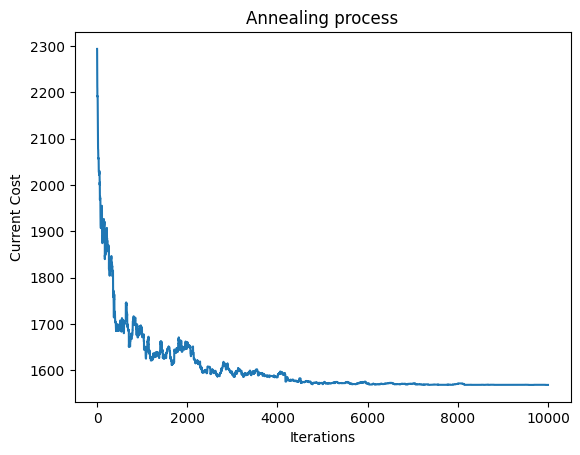

MovieWriter imagemagick unavailable; using Pillow instead.


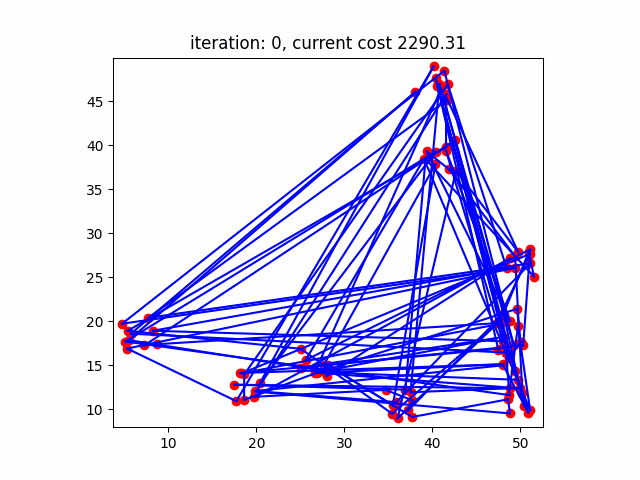

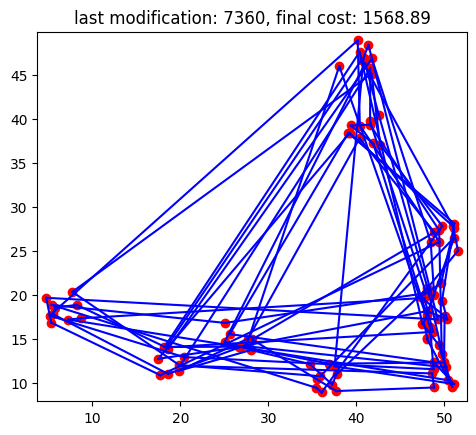

In [369]:
tsp = TSP(Points,T,max_iter,alpha,'consecutive') 

plot_annealing(tsp.ratio)
generate_gif(Points, tsp.history_for_gif,'group_consecutive.gif')

![title](resources/group_consecutive.gif)

Running the simulation on same points, but using arbitrary swap:

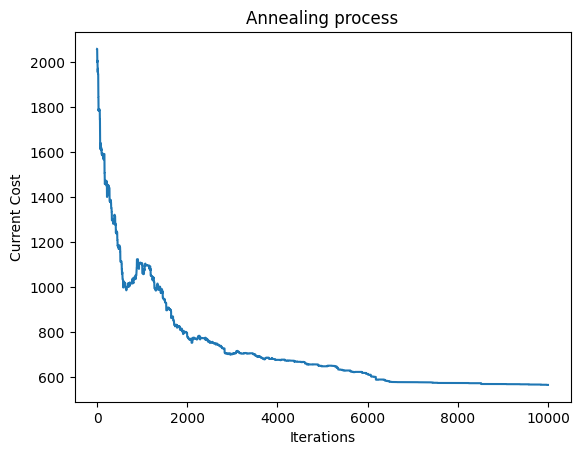

MovieWriter imagemagick unavailable; using Pillow instead.


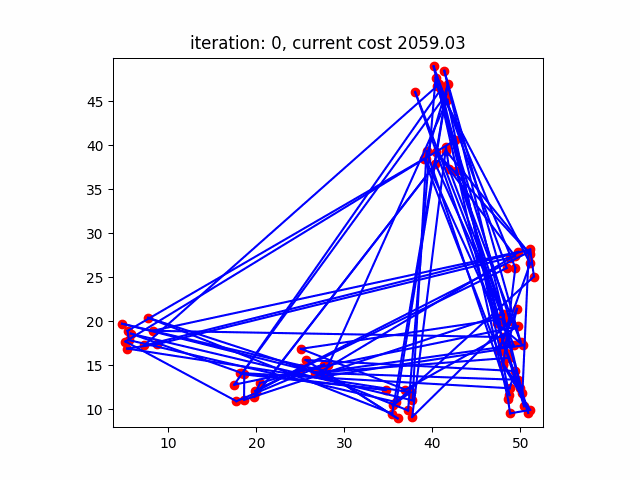

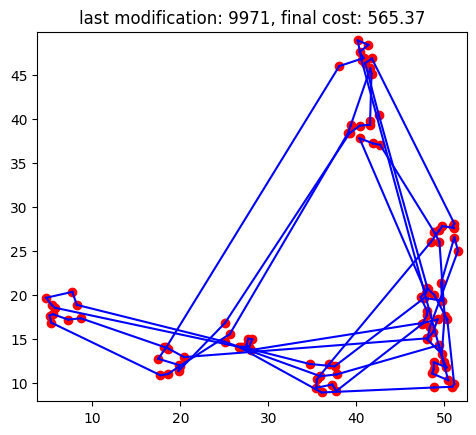

In [370]:
tsp = TSP(Points,T,max_iter,alpha,'arbitrary') 

plot_annealing(tsp.ratio)
generate_gif(Points, tsp.history_for_gif,'group_arbitrary.gif')


![title](resources/group_arbitrary.gif)

*Conclusions*:

End result is definitly much better than starting point, but still there is room for improvement, which indicates why simmulating anealing is not always good enough technique. We can clearly see that arbitrary swaps provides much better outcome. 

### Uniform distribution of points

Chosen parameteres:

In [371]:
n = 50
uniform_points = np.random.uniform(0,20,size=(n,2)) 
T = -1 
max_iter = 10_000
alpha = 0.9997


Simulation tested for consecutive swap:

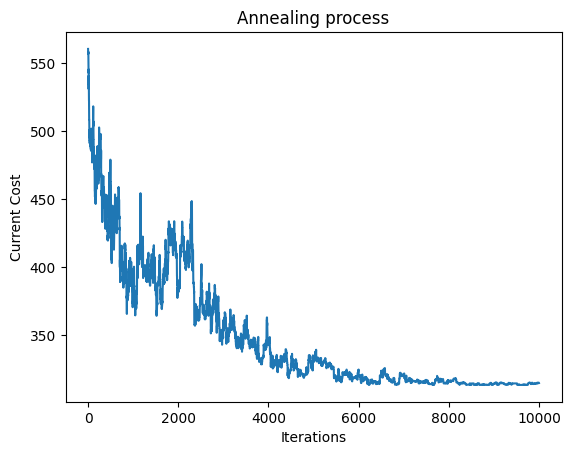

MovieWriter imagemagick unavailable; using Pillow instead.


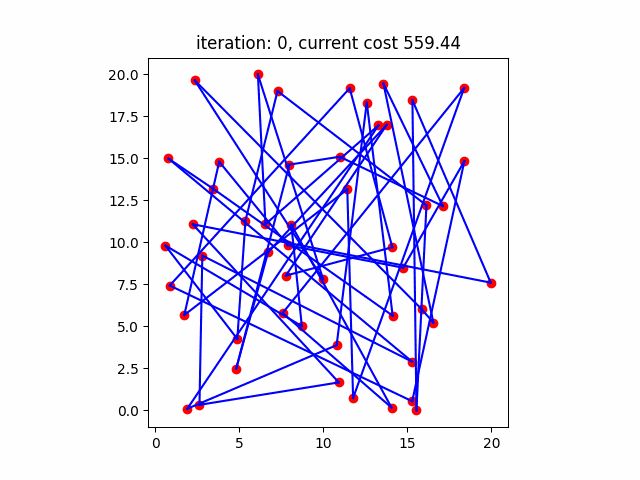

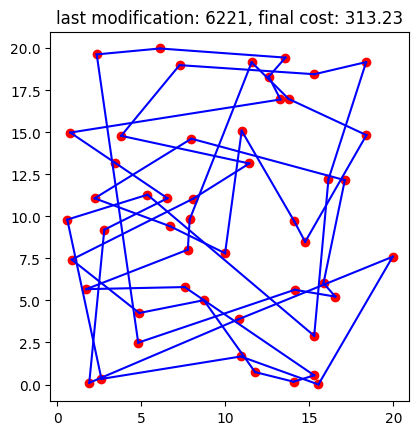

In [372]:
tsp = TSP(uniform_points,T,max_iter,alpha,'consecutive') 
plot_annealing(tsp.ratio)
generate_gif(uniform_points, tsp.history_for_gif,'uniform_consecutive.gif')

![title](resources/uniform_consecutive.gif)


Simulation tested for arbitrary swap: (same initial Points)

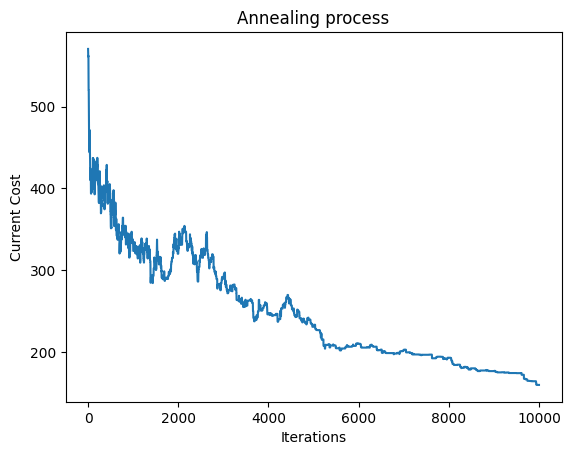

MovieWriter imagemagick unavailable; using Pillow instead.


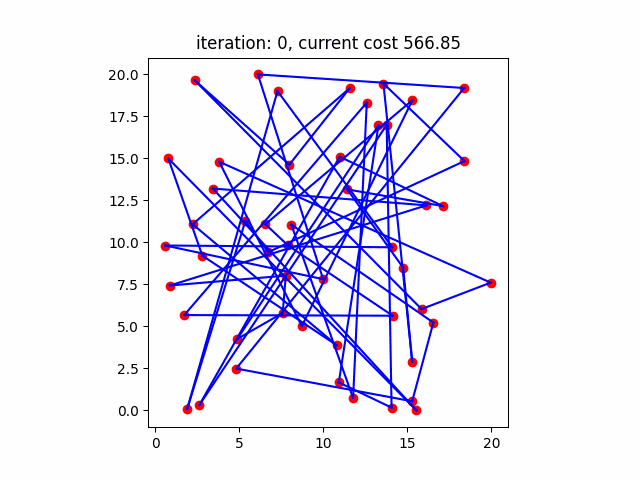

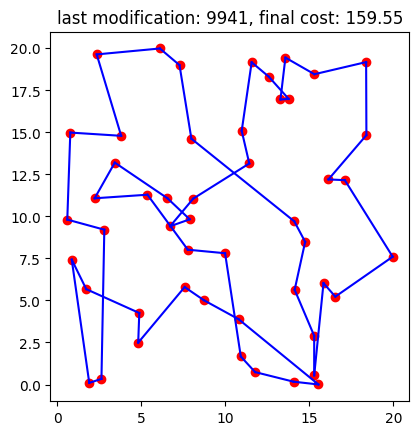

In [373]:
tsp = TSP(uniform_points,T,max_iter,alpha,'arbitrary') 
plot_annealing(tsp.ratio)
generate_gif(uniform_points,tsp.history_for_gif,'uniform_arbitrary.gif')

![title](resources/uniform_arbitrary.gif)


*Conclusions*:

Once again, the result of arbitrary swap is much better than outcome of simulation using consecutive swaps. I am actually not sure if it is not my mistake. I think that consecutive swap should be better in uniform points scenario. 

### Points from normal distribution
Chosen parameteres:

In [374]:
n = 100
mean = 0
std_dev = 10
normal_points = generate_normal_points(mean,std_dev,n)

T = -1 
max_iter = 10_000
alpha = 0.999

Running simulation for consecutive swaps:

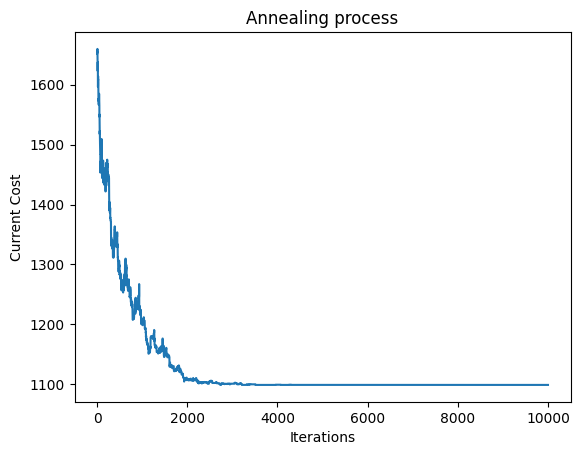

MovieWriter imagemagick unavailable; using Pillow instead.


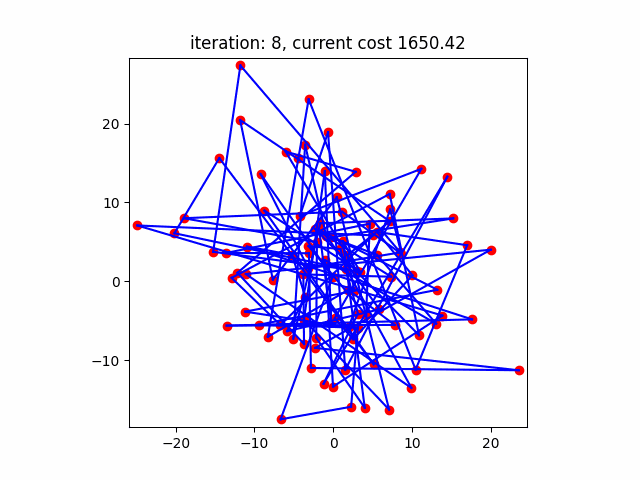

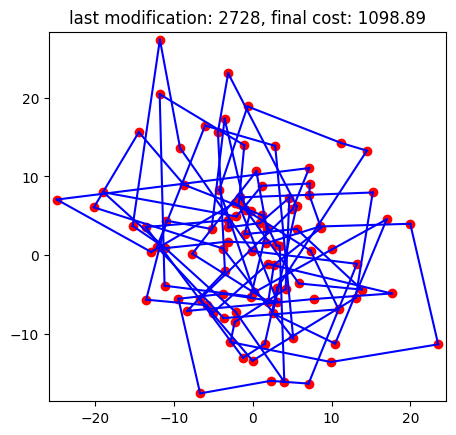

In [375]:
tsp = TSP(normal_points,T,max_iter,alpha,'consecutive') 
plot_annealing(tsp.ratio)
generate_gif(normal_points,tsp.history_for_gif,'normal_consecutive.gif')

![title](resources/normal_consecutive.gif)


Arbitrary swaps for exactly same points: 

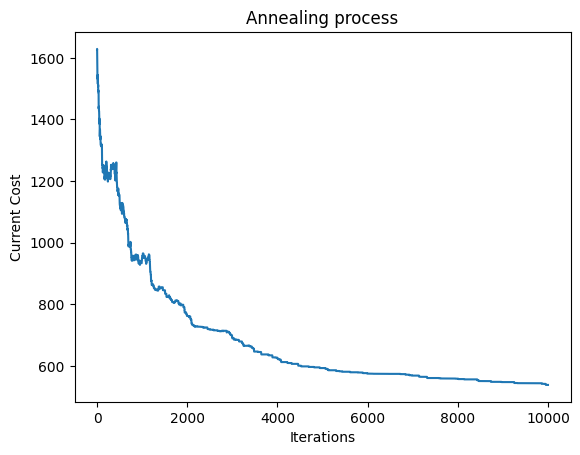

MovieWriter imagemagick unavailable; using Pillow instead.


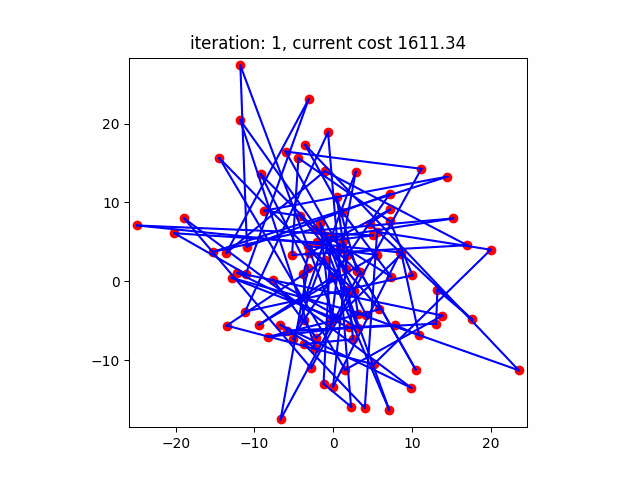

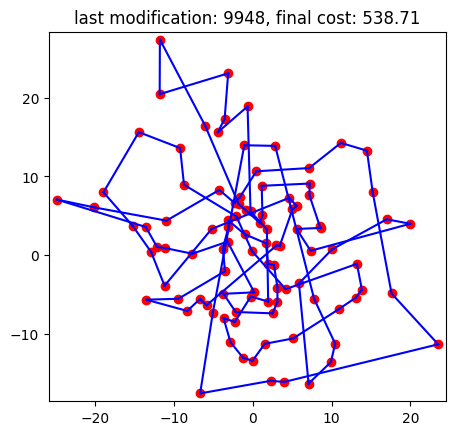

In [376]:
tsp = TSP(normal_points,T,max_iter,alpha,'arbitrary') 
plot_annealing(tsp.ratio)
generate_gif(normal_points,tsp.history_for_gif,'normal_arbitrary.gif')

![title](resources/normal_arbitrary.gif)


*Conclusions:*
In this scenario there is also a visible advantage of arbitrary swaps. 